In [1]:
import os
import numpy as np
import cv2
from glob import glob
import glob
import random
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from tensorflow.keras.layers import Input

In [2]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [3]:
os.environ["PYTHONHASHSEDD"] = str(42)
np.random.seed(42)
tf.random.set_seed(42)

In [4]:
batch_size = 1
lr = 0.001
epochs = 100
height = 512
width = 512

In [5]:
dataset_path = os.path.join("dataset")

In [6]:
files_dir = os.path.join("files")

In [8]:
model_file = os.path.join(files_dir, "unet.h5")
log_file = os.path.join(files_dir, "log.csv")

In [9]:
def create_dir(path):
    if not os.path.exists(path):
        os.makedirs(path)

In [10]:
create_dir(files_dir)

In [11]:
def conv_block(inputs, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(inputs)
    x = BatchNormalization(axis=3)(x)
    x = Activation("relu")(x)
    
#     x = Conv2D(num_filters, 3, padding="same")(x)
#     x = BatchNormalization(axis=3)(x)
#     x = Activation("relu")(x)
    
    return x


In [12]:
def encoder_block(inputs, num_filters):
    x = conv_block(inputs, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p

In [13]:
def decoder_block(inputs, skip, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding = "same")(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, num_filters)
    return x

In [14]:
def build_unet(input_shape):
    inputs = Input(input_shape)
    
    """Encoder"""
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)    
    s3, p3 = encoder_block(p2, 256)    
    s4, p4 = encoder_block(p3, 512)    
    
    """Bridge"""
    b1 = conv_block(p4, 1024)
    
    """Decoder"""
    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)    
    d3 = decoder_block(d2, s2, 128)    
    d4 = decoder_block(d3, s1, 65)   
    
    outputs = Conv2D(1, 1, padding = "same", activation= "sigmoid")(d4)
    
    model = Model(inputs, outputs, name = "UNET")
    return model

In [15]:
def load_data(path):
    all_x = sorted(glob.glob(os.path.join(path, "Image", "*")))
    all_y = sorted(glob.glob(os.path.join(path, "Mask", "*")))
    
    validation_size = int(0.2 * len(all_x))
    
    random.seed(42)
    
    validation_indices = random.sample(range(len(all_x)), validation_size)
    
    train_x = [all_x[i] for i in range(len(all_x)) if i not in validation_indices]
    train_y = [all_y[i] for i in range(len(all_y)) if i not in validation_indices]
    
    valid_x = [all_x[i] for i in validation_indices]
    valid_y = [all_y[i] for i in validation_indices]
    
    return train_x, train_y, valid_x, valid_y


In [16]:
def read_image(path):
    path = path.decode()
    try:
        x = cv2.imread(path, cv2.IMREAD_COLOR)
        if x is None:
            raise ValueError(f"Failed to read image from path: {path}")
        x = cv2.resize(x, (height, width))  
        x = x / 255.0
        return x
    except Exception as e:
        print(f"Error reading image: {path} - {e}")
        return None


In [17]:
def read_mask(path):
    path = path.decode()
    try:
        x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
        if x is None:
            raise ValueError(f"Failed to read mask from path: {path}")
        x = cv2.resize(x, (height, width))  
        x = x / 255.0
        x = np.expand_dims(x, axis=-1)
        return x
    except Exception as e:
        print(f"Error reading mask: {path} - {e}")
        return None


In [18]:
def tf_parse(x, y):
    def _parse(x, y):
        x = read_image(x)
        y = read_mask(y)
        return x, y
    x, y = tf.numpy_function(_parse, [x, y], [tf.float64, tf.float64])
    x.set_shape([height, width, 3])
    y.set_shape([height, width, 1])
    
    return x, y

In [19]:
def tf_dataset(x, y, batch=batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.map(tf_parse, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(batch)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset

In [20]:
train_x, train_y, valid_x, valid_y = load_data(dataset_path)

In [21]:
len(train_x)

199

In [22]:
len(train_y)

199

In [23]:
len(valid_x)

49

In [24]:
len(valid_y)

49

In [25]:
train_dataset = tf_dataset(train_x, train_y, batch=batch_size)
valid_dataset = tf_dataset(valid_x, valid_y, batch=batch_size)

In [26]:
for x, y in train_dataset:
    print(x.shape, y.shape)

(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 

In [27]:
for x, y in valid_dataset:
    print(x.shape, y.shape)

(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 3) (1, 512, 512, 1)
(1, 512, 512, 

In [28]:
input_shape = (height, width, 3)
model = build_unet(input_shape)

In [33]:
model.summary()

Model: "UNET"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 512, 512, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 512, 512, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                              

                                                                                                  
 activation_6 (Activation)      (None, 128, 128, 25  0           ['batch_normalization_6[0][0]']  
                                6)                                                                
                                                                                                  
 conv2d_transpose_2 (Conv2DTran  (None, 256, 256, 12  131200     ['activation_6[0][0]']           
 spose)                         8)                                                                
                                                                                                  
 concatenate_2 (Concatenate)    (None, 256, 256, 25  0           ['conv2d_transpose_2[0][0]',     
                                6)                                'activation_1[0][0]']           
                                                                                                  
 conv2d_7 

In [34]:
# def precision_score_(groundtruth_mask, pred_mask):
#     intersect = np.sum(pred_mask*groundtruth_mask)
#     total_pixel_pred = np.sum(pred_mask)
#     precision = np.mean(intersect/total_pixel_pred)
#     return round(precision, 3)

# def recall_score_(groundtruth_mask, pred_mask):
#     intersect = np.sum(pred_mask*groundtruth_mask)
#     total_pixel_truth = np.sum(groundtruth_mask)
#     recall = np.mean(intersect/total_pixel_truth)
#     return round(recall, 3)

# def accuracy(groundtruth_mask, pred_mask):
#     intersect = np.sum(pred_mask*groundtruth_mask)
#     union = np.sum(pred_mask) + np.sum(groundtruth_mask) - intersect
#     xor = np.sum(groundtruth_mask==pred_mask)
#     acc = np.mean(xor/(union + xor - intersect))
#     return round(acc, 3)

# def dice_coef(groundtruth_mask, pred_mask):
#     intersect = np.sum(pred_mask*groundtruth_mask)
#     total_sum = np.sum(pred_mask) + np.sum(groundtruth_mask)
#     dice = np.mean(2*intersect/total_sum)
#     return round(dice, 3) #round up to 3 decimal places

# def iou(groundtruth_mask, pred_mask):
#     intersect = np.sum(pred_mask*groundtruth_mask)
#     union = np.sum(pred_mask) + np.sum(groundtruth_mask) - intersect
#     iou = np.mean(intersect/union)
#     return round(iou, 3)

# def dice_coef(y_true, y_pred, smooth=1.):
#   """
#   Dice = (2*|X & Y|)/ (|X|+ |Y|)
#         =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
#   ref: https://arxiv.org/pdf/1606.04797v1.pdf
#   """
#   y_true_f = tf.keras.backend.flatten(y_true)
#   y_pred_f = tf.keras.backend.flatten(y_pred)
#   intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
#   return (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

In [30]:
# def precision_score(groundtruth_mask, pred_mask):
#     intersect = tf.keras.backend.sum(pred_mask * groundtruth_mask)
#     total_pixel_pred = tf.keras.backend.sum(pred_mask)
#     precision = tf.keras.backend.mean(intersect / total_pixel_pred)
#     return tf.keras.backend.round(precision)

# def recall_score(groundtruth_mask, pred_mask):
#     intersect = tf.keras.backend.sum(pred_mask * groundtruth_mask)
#     total_pixel_truth = tf.keras.backend.sum(groundtruth_mask)
#     recall = tf.keras.backend.mean(intersect / total_pixel_truth)
#     return tf.keras.backend.round(recall)

# def accuracy(groundtruth_mask, pred_mask):
#     intersect = tf.keras.backend.sum(pred_mask * groundtruth_mask)
#     union = tf.keras.backend.sum(pred_mask) + tf.keras.backend.sum(groundtruth_mask) - intersect
#     xor = tf.keras.backend.sum(tf.keras.backend.cast(groundtruth_mask == pred_mask, dtype=tf.float32))
#     acc = tf.keras.backend.mean(xor / (union + xor - intersect))
#     return tf.keras.backend.round(acc)

# def dice_coef(groundtruth_mask, pred_mask, smooth=1.):
#     y_true_f = tf.keras.backend.flatten(groundtruth_mask)
#     y_pred_f = tf.keras.backend.flatten(pred_mask)
#     intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
#     return (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

def iou(groundtruth_mask, pred_mask):
    intersect = tf.keras.backend.sum(pred_mask * groundtruth_mask)
    union = tf.keras.backend.sum(pred_mask) + tf.keras.backend.sum(groundtruth_mask) - intersect
    iou = tf.keras.backend.mean(intersect / union)
    return tf.keras.backend.round(iou)

In [31]:
opt = tf.keras.optimizers.Adam(lr)
model.compile(loss = "binary_crossentropy", optimizer=opt, metrics=["accuracy", iou])

In [32]:
callbacks = [
    ModelCheckpoint(model_file, verbose = 1, save_best_only=True),
    ReduceLROnPlateau(monitor= "val_loss", factor=0.1, patience=3),
    CSVLogger(log_file),
    EarlyStopping(monitor="val_loss", patience=20, restore_best_weights=False)
]

In [38]:
history = model.fit(
    train_dataset, validation_data=valid_dataset, epochs=epochs, callbacks=callbacks
)

Epoch 1/100
199/199 [==============================] - ETA: 0s - loss: 0.4619 - accuracy: 0.7842 - iou: 0.4673
Epoch 1: val_loss improved from inf to 5.50424, saving model to files/unet.h5
199/199 [==============================] - 72s 284ms/step - loss: 0.4619 - accuracy: 0.7842 - iou: 0.4673 - val_loss: 5.5042 - val_accuracy: 0.3885 - val_iou: 0.3265 - lr: 0.0010
Epoch 2/100
199/199 [==============================] - ETA: 0s - loss: 0.4118 - accuracy: 0.8108 - iou: 0.6080
Epoch 2: val_loss improved from 5.50424 to 2.72587, saving model to files/unet.h5
199/199 [==============================] - 84s 422ms/step - loss: 0.4118 - accuracy: 0.8108 - iou: 0.6080 - val_loss: 2.7259 - val_accuracy: 0.3939 - val_iou: 0.3469 - lr: 0.0010
Epoch 3/100
199/199 [==============================] - ETA: 0s - loss: 0.3877 - accuracy: 0.8226 - iou: 0.6231
Epoch 3: val_loss improved from 2.72587 to 0.46571, saving model to files/unet.h5
199/199 [==============================] - 71s 355ms/step - loss: 0

199/199 [==============================] - 65s 328ms/step - loss: 0.2712 - accuracy: 0.8829 - iou: 0.8291 - val_loss: 0.3255 - val_accuracy: 0.8426 - val_iou: 0.5714 - lr: 1.0000e-05
Epoch 24/100
199/199 [==============================] - ETA: 0s - loss: 0.2708 - accuracy: 0.8830 - iou: 0.8291
Epoch 24: val_loss improved from 0.32553 to 0.32536, saving model to files/unet.h5
199/199 [==============================] - 57s 287ms/step - loss: 0.2708 - accuracy: 0.8830 - iou: 0.8291 - val_loss: 0.3254 - val_accuracy: 0.8427 - val_iou: 0.5714 - lr: 1.0000e-05
Epoch 25/100
199/199 [==============================] - ETA: 0s - loss: 0.2704 - accuracy: 0.8832 - iou: 0.8291
Epoch 25: val_loss improved from 0.32536 to 0.32519, saving model to files/unet.h5
199/199 [==============================] - 57s 285ms/step - loss: 0.2704 - accuracy: 0.8832 - iou: 0.8291 - val_loss: 0.3252 - val_accuracy: 0.8428 - val_iou: 0.5714 - lr: 1.0000e-05
Epoch 26/100
199/199 [==============================] - ETA: 

Epoch 67/100
199/199 [==============================] - ETA: 0s - loss: 0.2537 - accuracy: 0.8900 - iou: 0.8442
Epoch 67: val_loss did not improve from 0.31578
199/199 [==============================] - 56s 280ms/step - loss: 0.2537 - accuracy: 0.8900 - iou: 0.8442 - val_loss: 0.3159 - val_accuracy: 0.8491 - val_iou: 0.5714 - lr: 1.0000e-05
Epoch 68/100
199/199 [==============================] - ETA: 0s - loss: 0.2534 - accuracy: 0.8901 - iou: 0.8442
Epoch 68: val_loss improved from 0.31578 to 0.31541, saving model to files/unet.h5
199/199 [==============================] - 56s 283ms/step - loss: 0.2534 - accuracy: 0.8901 - iou: 0.8442 - val_loss: 0.3154 - val_accuracy: 0.8495 - val_iou: 0.5918 - lr: 1.0000e-05
Epoch 69/100
199/199 [==============================] - ETA: 0s - loss: 0.2530 - accuracy: 0.8902 - iou: 0.8543
Epoch 69: val_loss improved from 0.31541 to 0.31536, saving model to files/unet.h5
199/199 [==============================] - 56s 284ms/step - loss: 0.2530 - accuracy:

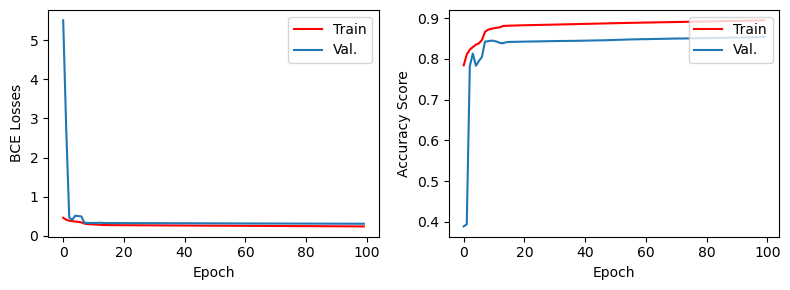

In [84]:
plt.figure(figsize=(12,3))
plt.subplot(1,3,1)
plt.plot(history.history['loss'], color='r')
plt.plot(history.history['val_loss'])
plt.ylabel('BCE Losses')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val.'], loc='upper right')

plt.subplot(1,3,2)
plt.plot(history.history['accuracy'], color='r')
plt.plot(history.history['val_accuracy'])
plt.ylabel('Accuracy Score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val.'], loc='upper right')

plt.tight_layout()

plt.show()

In [33]:
def read_image_testing(path):
    try:
        x = cv2.imread(path, cv2.IMREAD_COLOR)
        if x is None:
            raise ValueError(f"Failed to read image from path: {path}")
        x = cv2.resize(x, (height, width)) 
        x = x / 255.0
        return x
    except Exception as e:
        print(f"Error reading image: {path} - {e}")
        return None

def read_mask_testing(path):
    try:
        x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
        if x is None:
            raise ValueError(f"Failed to read mask from path: {path}")
        x = cv2.resize(x, (height, width))  
        x = x / 255.0
        x = np.expand_dims(x, axis=-1)
        return x
    except Exception as e:
        print(f"Error reading mask: {path} - {e}")
        return None


In [34]:
model.load_weights("/home/mostafatarek/Downloads/Flood Area Segmentation/files/unet.h5")

1/1 [==============================] - 0s 17ms/step
dataset/Image/3075.jpg


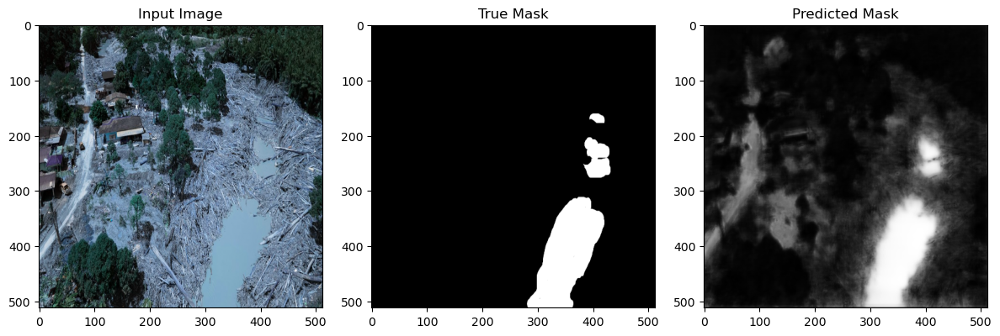

1/1 [==============================] - 0s 24ms/step
dataset/Image/2005.jpg


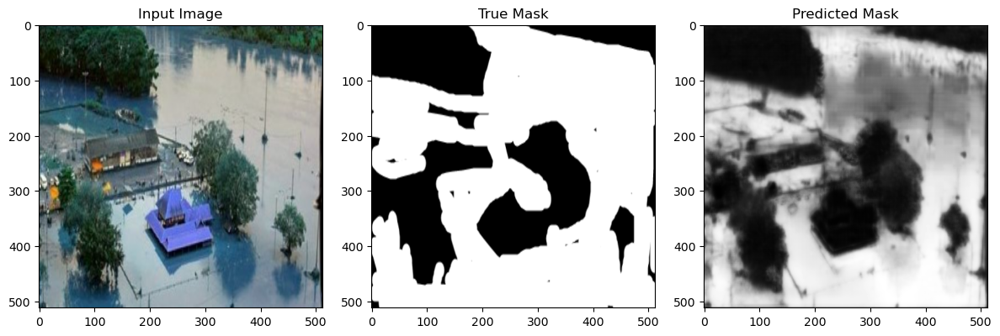

1/1 [==============================] - 0s 18ms/step
dataset/Image/1032.jpg


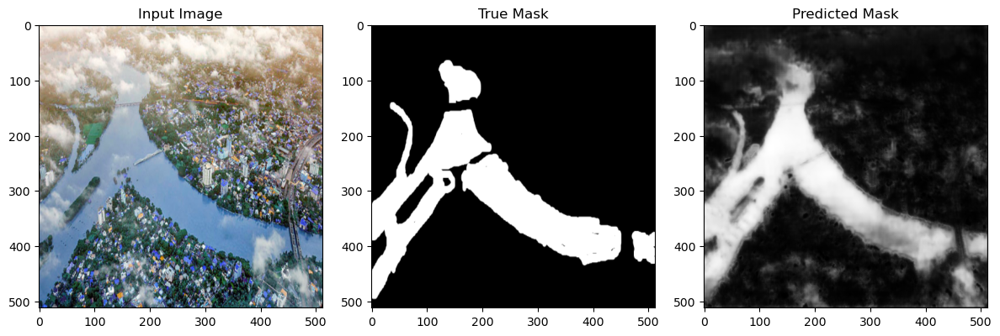

1/1 [==============================] - 0s 21ms/step
dataset/Image/1075.jpg


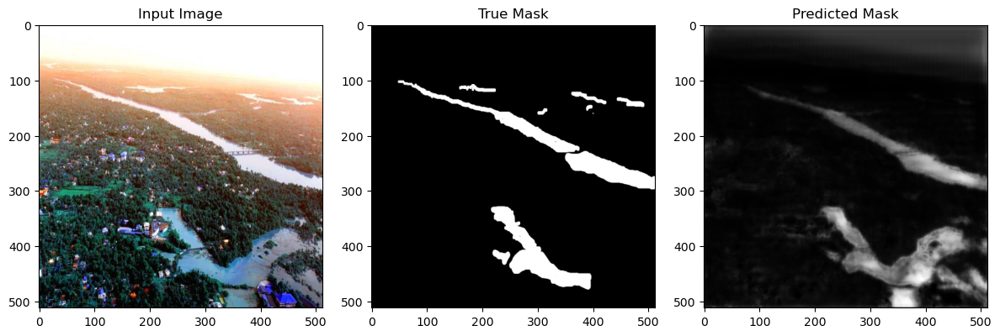

1/1 [==============================] - 0s 21ms/step
dataset/Image/3055.jpg


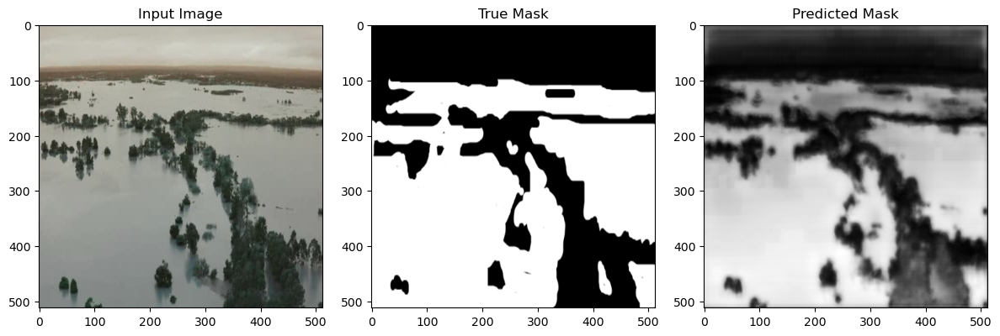

In [37]:
num_samples_to_visualize = 5
sample_indices = np.random.choice(len(valid_x), num_samples_to_visualize, replace=False)

for idx in sample_indices:
    input_path = valid_x[idx]
    mask_path = valid_y[idx]
    
    input_image = read_image_testing(input_path)
    true_mask = read_mask_testing(mask_path)
    
    input_image_batch = np.expand_dims(input_image, axis=0)
    predicted_mask = model.predict(input_image_batch)[0]
    
    print(input_path)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(input_image)
    plt.title("Input Image")
    
    plt.subplot(1, 3, 2)
    plt.imshow(np.squeeze(true_mask), cmap='gray')
    plt.title("True Mask")
    
    plt.subplot(1, 3, 3)
    plt.imshow(np.squeeze(predicted_mask), cmap='gray')
    plt.title("Predicted Mask")
    
    plt.tight_layout()
    plt.show()

1/1 [==============================] - 0s 15ms/step
dataset/Image/1045.jpg


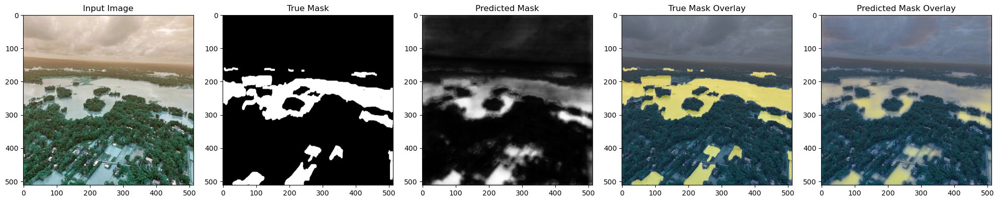

1/1 [==============================] - 0s 31ms/step
dataset/Image/3076.jpg


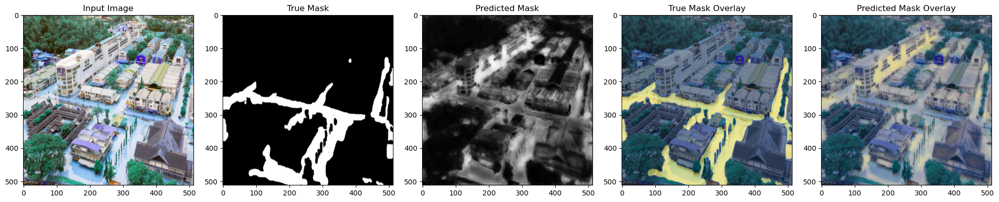

1/1 [==============================] - 0s 18ms/step
dataset/Image/3062.jpg


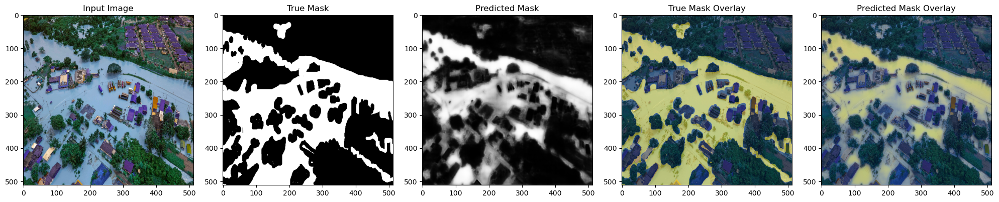

1/1 [==============================] - 0s 38ms/step
dataset/Image/3055.jpg


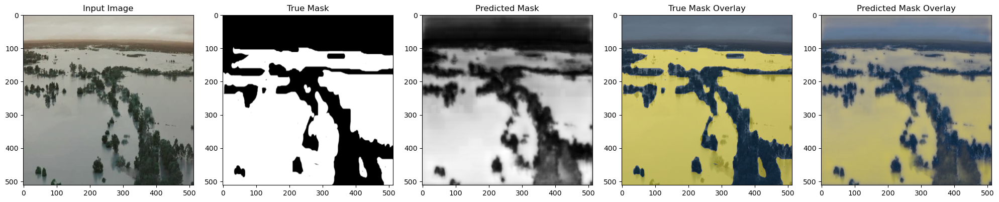

1/1 [==============================] - 0s 19ms/step
dataset/Image/5.jpg


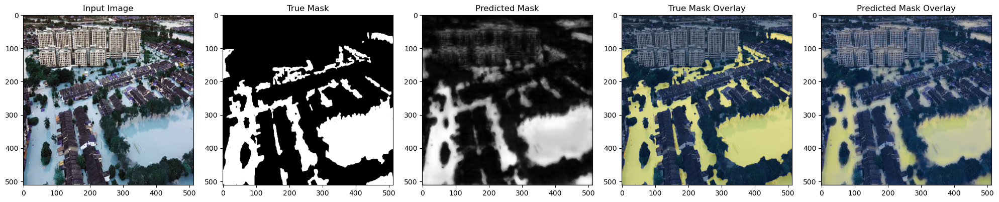

In [38]:
import numpy as np
import matplotlib.pyplot as plt

num_samples_to_visualize = 5
sample_indices = np.random.choice(len(valid_x), num_samples_to_visualize, replace=False)

for idx in sample_indices:
    input_path = valid_x[idx]
    mask_path = valid_y[idx]
    
    input_image = read_image_testing(input_path)
    true_mask = read_mask_testing(mask_path)
    
    input_image_batch = np.expand_dims(input_image, axis=0)
    predicted_mask = model.predict(input_image_batch)[0]
    
    print(input_path)
    plt.figure(figsize=(20, 6))  
    
    plt.subplot(1, 5, 1)  
    plt.imshow(input_image)
    plt.title("Input Image")
    
    plt.subplot(1, 5, 2)  
    plt.imshow(np.squeeze(true_mask), cmap='gray')
    plt.title("True Mask")
    
    plt.subplot(1, 5, 3)
    plt.imshow(np.squeeze(predicted_mask), cmap='gray')
    plt.title("Predicted Mask")
    
    plt.subplot(1, 5, 4) 
    plt.imshow(input_image)
    plt.imshow(np.squeeze(true_mask), cmap='cividis', alpha=0.5)
    plt.title("True Mask Overlay")
    
    plt.subplot(1, 5, 5)  
    plt.imshow(input_image) 
    plt.imshow(np.squeeze(predicted_mask), cmap='cividis', alpha=0.5)  
    plt.title("Predicted Mask Overlay")
    
    plt.tight_layout()
    plt.show()


1/1 [==============================] - 0s 36ms/step


dataset/Image/3040.jpg
dataset/Image/3040.jpg


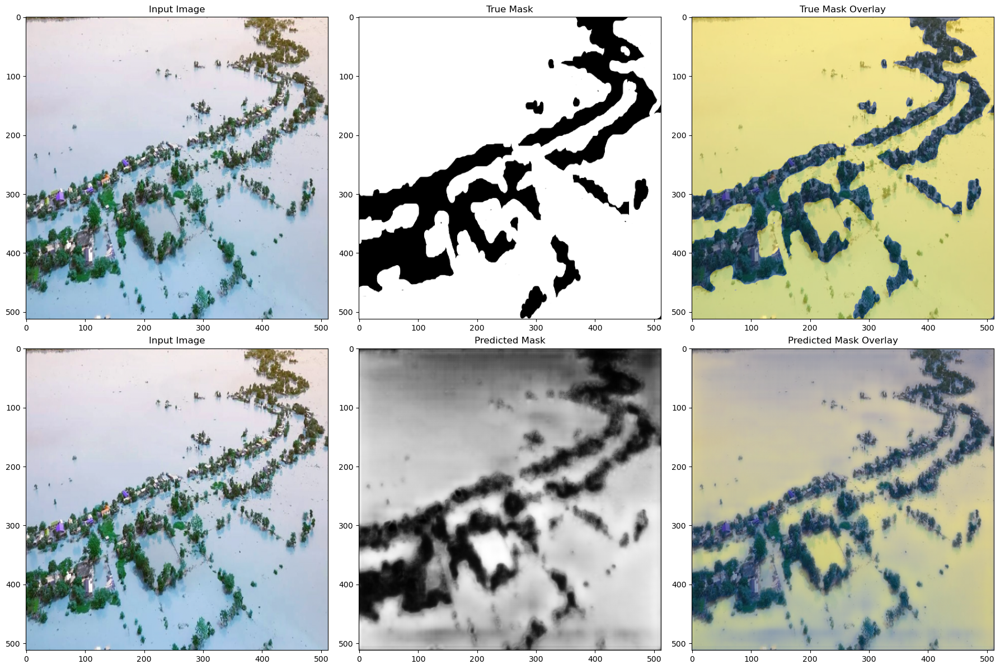

1/1 [==============================] - 0s 44ms/step
dataset/Image/3061.jpg
dataset/Image/3061.jpg


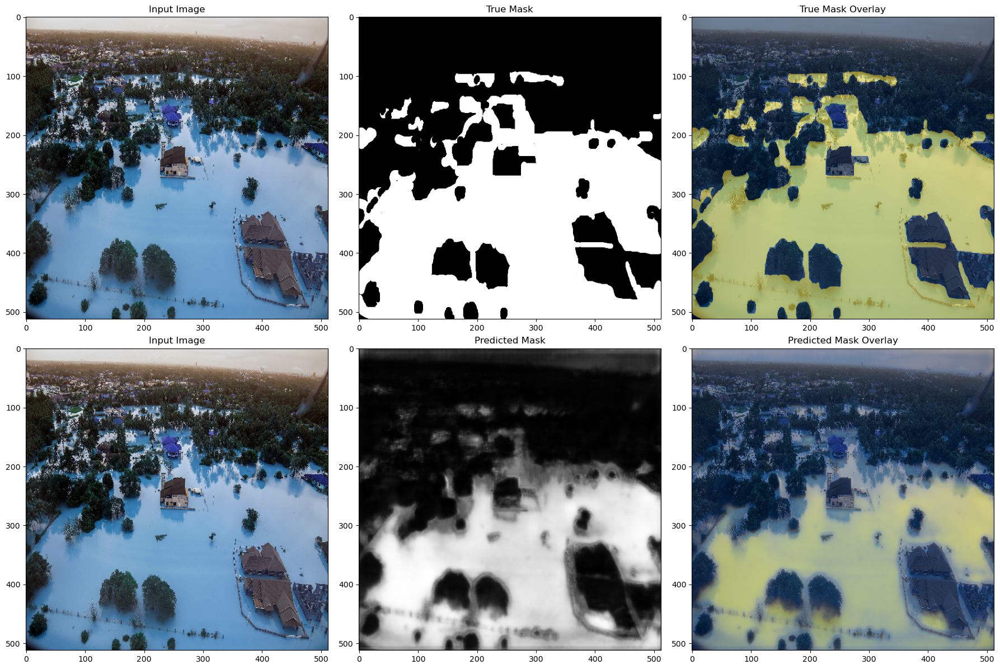

1/1 [==============================] - 0s 17ms/step
dataset/Image/1005.jpg
dataset/Image/1005.jpg


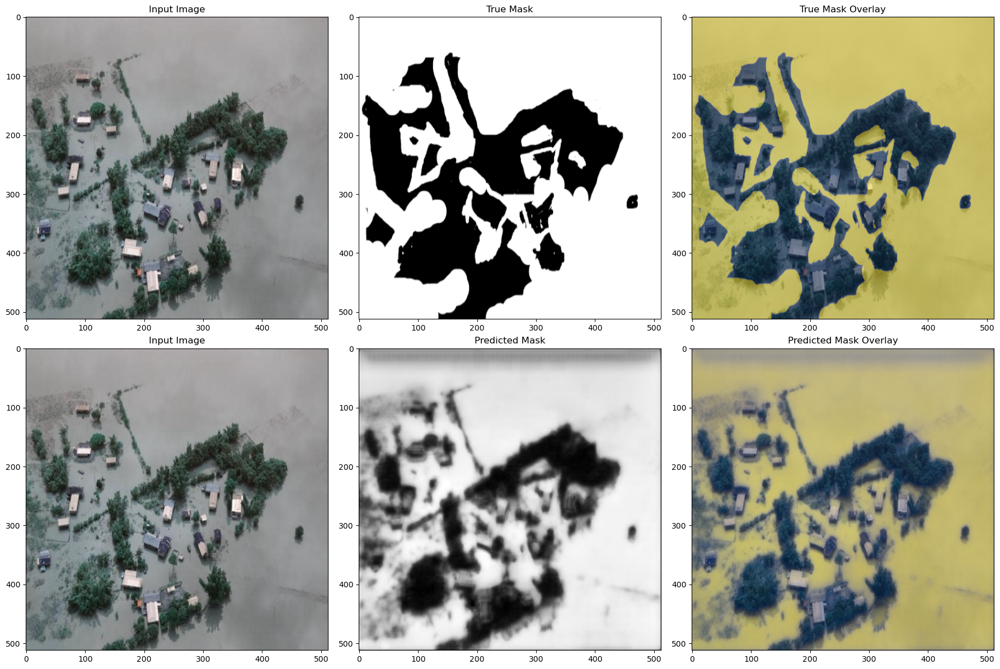

1/1 [==============================] - 0s 24ms/step
dataset/Image/1045.jpg
dataset/Image/1045.jpg


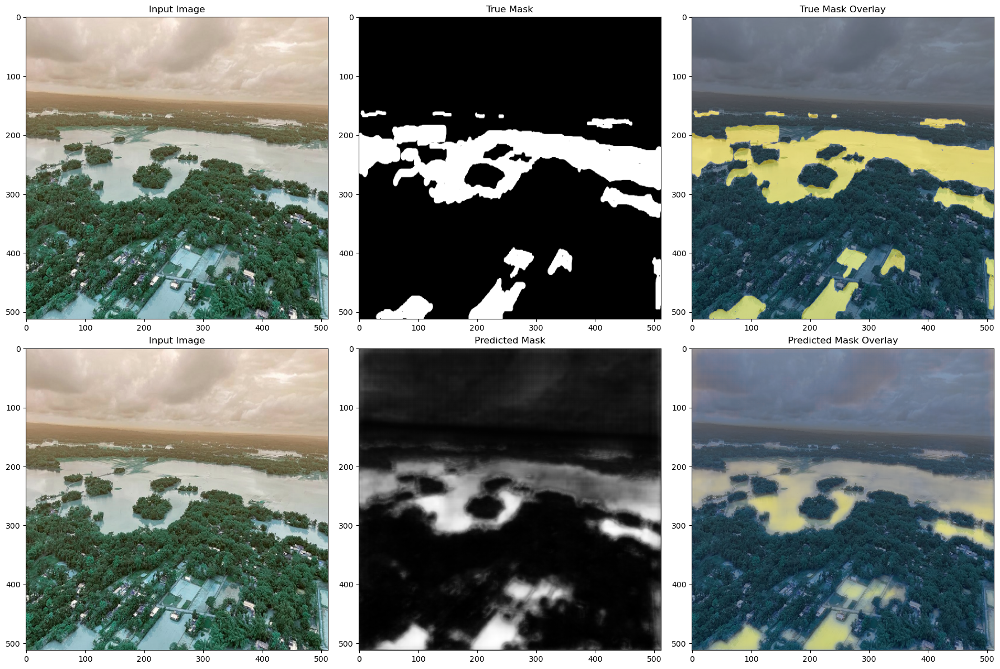

1/1 [==============================] - 0s 19ms/step
dataset/Image/3082.jpg
dataset/Image/3082.jpg


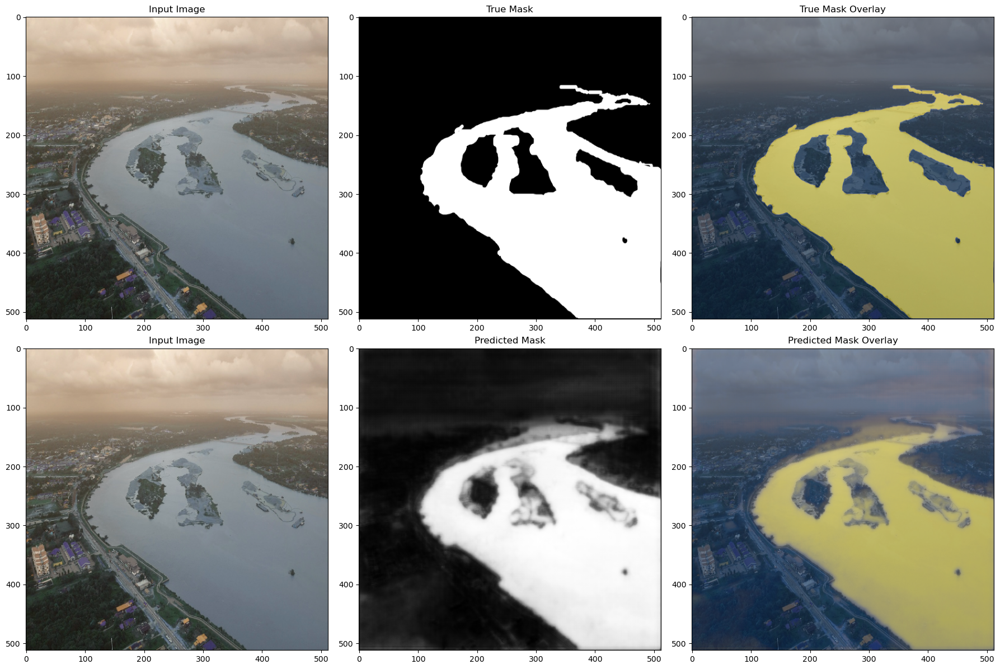

In [36]:
import numpy as np
import matplotlib.pyplot as plt

num_samples_to_visualize = 5
sample_indices = np.random.choice(len(valid_x), num_samples_to_visualize, replace=False)

for idx in sample_indices:
    input_path = valid_x[idx]
    mask_path = valid_y[idx]
    
    input_image = read_image_testing(input_path)
    true_mask = read_mask_testing(mask_path)
    
    input_image_batch = np.expand_dims(input_image, axis=0)
    predicted_mask = model.predict(input_image_batch)[0]
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    print(input_path)

    axes[0, 0].imshow(input_image)
    axes[0, 0].set_title("Input Image")
    
    axes[0, 1].imshow(np.squeeze(true_mask), cmap='gray')
    axes[0, 1].set_title("True Mask")
    
    axes[0, 2].imshow(input_image)
    axes[0, 2].imshow(np.squeeze(true_mask), cmap='cividis', alpha=0.5)
    axes[0, 2].set_title("True Mask Overlay")
    
    axes[1, 0].imshow(input_image)
    axes[1, 0].set_title("Input Image")
    
    axes[1, 1].imshow(np.squeeze(predicted_mask), cmap='gray')
    axes[1, 1].set_title("Predicted Mask")
    
    axes[1, 2].imshow(input_image)
    axes[1, 2].imshow(np.squeeze(predicted_mask), cmap='cividis', alpha=0.5)
    axes[1, 2].set_title("Predicted Mask Overlay")
    
    plt.tight_layout()
    
    plt.show()
